In [1]:
#instalando libs necessárias
# !pip install ydata-profiling ipywidgets category_encoders scikit-learn matplotlib seaborn imblearn powershap

In [1]:
%matplotlib inline

## Previsão de popularidade de música no Spotify

Neste notebook realizaremos o estudo de um modelo para previsão de popularidade de uma música no Spotify.

Link do dataset: https://www.kaggle.com/datasets/priyamchoksi/spotify-dataset-114k-songs/data




### Informações sobre o dataset

Spotify Tracks Dataset Description

This dataset contains information on Spotify tracks spanning 125 different genres. Each track is described by various audio features and metadata. The dataset can be utilized for:

Building recommendation systems based on user preferences or inputs.

Classification tasks based on audio features and genre categorization.

Columns Description:

**track_id:** The unique Spotify ID for each track.

**artists:** Names of the artists who performed the track, separated by ';'.

**album_name:** The name of the album in which the track appears.

**track_name:** The title of the track.

**popularity:** A value between 0 and 100, indicating the track's popularity based on recent plays.

**duration_ms:** The length of the track in milliseconds.

**explicit:** Boolean indicating whether the track contains explicit content.

**danceability:** Describes how suitable a track is for dancing (0.0 = least danceable, 1.0 = most danceable).

**energy:** Represents the intensity and activity of a track (0.0 = low energy, 1.0 = high energy).

**key:** The musical key of the track mapped using standard Pitch Class notation.

**loudness:** Overall loudness of the track in decibels (dB).

**mode:** Indicates the modality (major or minor) of the track.
speechiness: Detects the presence of spoken words in the track.

**acousticness:** Confidence measure of whether the track is acoustic (0.0 = not acoustic, 1.0 = highly acoustic).

**instrumentalness:** Predicts whether a track contains vocals (0.0 = contains vocals, 1.0 = instrumental).

**liveness:** Detects the presence of an audience in the recording (0.0 = studio recording, 1.0 = live performance).

**valence:** Measures the musical positiveness conveyed by a track (0.0 = negative, 1.0 = positive).

**tempo:** Estimated tempo of the track in beats per minute (BPM).

**time_signature**: Estimated time signature of the track (3 to 7).

Each track is associated with a specific genre labeled under track_genre.


## Carregando os Dados para o Database PostgreSQL

* Certifique-se de que os Containers estão com estado "Running", em especial os containers "postgres:16.4" e "tech_challenge-api-data"
* Verifique se a conexão com o Banco PostgreSQL está funcionando a partir da chamada "http://localhost:8000/connect_db", que deve retornar "Connection Passed". Caso contrário, verifique se não há nenhum problema com os containers e com o banco de dados.
* Faça um request para o endereço "http://localhost:8000/load_data_to_db", e a carga dos dados será realizada no Banco PostgreSQL, com retorno esperado "The file ./data/spotify_raw_dataset.csv has been loaded to psql database. !x!"

### Lendo o dataset no formato pandas dataframe

In [4]:
import pandas as pd
from interfaces.db_interfaces import DBInterface
from interfaces.db_definitions import DatabaseDefs


db_defs = DatabaseDefs()
db_interface = DBInterface(
    user=db_defs.POSTGRES_USER,
    password=db_defs.POSTGRES_PASSWORD,
    db_name=db_defs.POSTGRES_DB,
    hostname=db_defs.POSTGRES_HOST
)

engine = db_interface.get_connection_engine()

df = pd.DataFrame()

df = pd.read_sql_query('Select * from "Spotify_Songs"', con=engine)

pd.set_option('display.max_columns', None)

df.head()

ModuleNotFoundError: No module named 'db_interfaces'

Podemos observar que as colunas unnamed e track_id não trarão nenhuma informação relevante para o meu modelo, então já iremos retirá-las

In [3]:
df_cleaned = df.drop(columns=['Unnamed: 0','track_id'])
df_cleaned.head()

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


### Análise exploratória
Aqui, utilizaremos o Profile Report para auxiliar na análise exploratória dos dados

In [6]:
from ydata_profiling import ProfileReport

# Generate a profiling report
profile = ProfileReport(df_cleaned, title="YData Profiling Report", explorative=True)

# To display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Limpeza dos Dados

In [4]:
#retirando valores nulos
df_cleaned = df_cleaned.dropna()

print(" \nTotal de nulos no DataFrame : \n\n", df_cleaned.isnull().sum())

 
Total de nulos no DataFrame : 

 artists             0
album_name          0
track_name          0
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64


In [5]:
df_cleaned.shape

(113999, 19)

In [6]:
#tirando linhas duplicadas

df_cleaned = df_cleaned.drop_duplicates()

df_cleaned.shape

(113422, 19)

Vimos que algumas variáveis possuem alta correlação, vamos seguir com alguns testes de seleção de features e realizar alguns pré processamentos de acordo com o modelo testado.

### Funções para reutilizar

#### Pré processamento dos dados

Vamos criar uma função para pré processamento que pode ser utilizada por vários modelos.

In [7]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from category_encoders import CatBoostEncoder

def preprocessing(model,categorical_features, continuous_features):

  # Pré-processador para variáveis contínuas
  continuous_transformer = Pipeline(steps=[
      ('scaler', MinMaxScaler())
  ])

  # Pré-processador para variáveis categóricas
  categorical_transformer = Pipeline(steps=[
      ('encoder', CatBoostEncoder())
  ])

  # Combinar os pré-processadores usando ColumnTransformer
  preprocessor = ColumnTransformer(
      transformers=[
        ('num', continuous_transformer, continuous_features),
        ('cat', categorical_transformer, categorical_features)
  ])


  # Criar a pipeline completa
  pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', model)
  ])

  return pipeline

#### Importância de features
Vamos criar uma função que retorna um gráfico com a importância de features e pode ser usada por todos os modelos.



In [8]:
import matplotlib.pyplot as plt
import seaborn as sns

def feature_importance(pipeline,continuous_features,categorical_features):

  # Extrair o modelo treinado da pipeline
  model = pipeline.named_steps['model']

  # Extrair a importância das características
  importances = model.feature_importances_

  # Obter os nomes das características após o pré-processamento
  feature_names = continuous_features + categorical_features  # Simplesmente concatenar as listas
  preprocessed_feature_names = pipeline.named_steps['preprocessor'].transformers_[1][1].named_steps['encoder'].get_feature_names_out(categorical_features)

  # Combinar os nomes das características contínuas e categóricas
  final_feature_names = continuous_features + list(preprocessed_feature_names)

  # Criar um DataFrame para visualizar as importâncias
  feature_importance_df = pd.DataFrame({
    'feature': final_feature_names,
    'importance': importances
  })

  # Ordenar por importância
  feature_importance_df = feature_importance_df.sort_values(by='importance', ascending=False)

  # Visualizar a importância das características
  plt.figure(figsize=(10, 6))
  sns.barplot(x='importance', y='feature', data=feature_importance_df)
  plt.title('Importância das Características')
  plt.xlabel('Importância')
  plt.ylabel('Característica')
  return plt.show()

#### Curva de aprendizado
Vamos criar uma função que irá plotar a curva de aprendizado do modelo testado.

In [9]:
from sklearn.model_selection import learning_curve
import numpy as np
import os

os.environ['JOBLIB_TEMP_FOLDER'] = '/tmp'

# Função para plotar a curva de aprendizagem
def plot_learning_curve(estimator, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure(figsize=(10, 6))
    plt.title("Curva de Aprendizagem")
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Tamanho do Conjunto de Treinamento")
    plt.ylabel("Pontuação")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                    train_scores_mean + train_scores_std, alpha=0.1,
                    color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                    test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
            label="Pontuação de Treino")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
            label="Pontuação de Validação")

    plt.legend(loc="best")
    return plt

#### Grid search

Vamso criar uma função para buscar os parâmetros mais otimizados de acordo com a métrica escolhida

In [10]:
from sklearn.model_selection import GridSearchCV

def busca_melhor_modelo(pipeline, param_grid, X_train, y_train, scoring_metric, cv=5):

  # Realizar a busca em grade para encontrar os melhores parâmetros
  grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring=scoring_metric)
  grid_search.fit(X_train, y_train)

  # Imprimir os melhores parâmetros encontrados
  print("Melhores parâmetros encontrados:")
  print(grid_search.best_params_)

  # Utilizar o modelo com os melhores parâmetros
  best_rf_classifier = grid_search.best_estimator_

  return best_rf_classifier


#### Avalia modelo classificacao
Vamos criar uma função para gerar a curva roc e matriz de confusão para os modelos de classificacao

In [11]:
from sklearn.metrics import roc_curve, roc_auc_score, classification_report
from sklearn.model_selection import cross_val_score, StratifiedKFold
import matplotlib.pyplot as plt

def avalia_modelo_classificacao(modelo,x_train,y_train,x_test,y_test):
    # Fazendo previsões de probabilidades para o conjunto de teste e de treino
    prob_predic_test = modelo.predict_proba(x_test)
    prob_predic_train = modelo.predict_proba(x_train)

    y_pred_probs_test = prob_predic_test[:, 1]
    y_pred_probs_train = prob_predic_train[:, 1]

    print(f"\n------------------------------Resultados {modelo}------------------------------\n")

    # Calculando a AUC (área sob a curva ROC) para o conjunto de teste e treino
    auc_test = roc_auc_score(y_test, y_pred_probs_test)
    auc_train = roc_auc_score(y_train, y_pred_probs_train)
    print(f"AUC (Teste) {auc_test:.2f}")
    print(f"AUC (Treino) {auc_train:.2f}")

    # Fazendo a predição dos dados de teste e calculando o classification report
    predicao = modelo.predict(x_test)
    print("\nClassification Report")
    print(classification_report(y_test, predicao, zero_division=0))

    print("\nRoc Curve\n")
    # Calcular a curva ROC para o conjunto de teste e treino
    fpr_test, tpr_test, _ = roc_curve(y_test, y_pred_probs_test)
    fpr_train, tpr_train, _ = roc_curve(y_train, y_pred_probs_train)

    # Plotar a curva ROC para o conjunto de teste e treino
    plt.figure(figsize=(8, 6))
    plt.plot(fpr_test, tpr_test, color='blue', lw=2, label=f'ROC curve Teste (AUC = {auc_test:.2f})')
    plt.plot(fpr_train, tpr_train, color='green', lw=2, label=f'ROC curve Treino (AUC = {auc_train:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Taxa de Falso Positivo')
    plt.ylabel('Taxa de Verdadeiro Positivo')
    plt.title('Curva ROC para Conjuntos de Treino e Teste')
    plt.legend(loc='lower right')
    plt.show()


### Aprendizado supervisionado
Vamos testar algumas abordagens dentro do aprendizado de máquina supervisionado

#### Problema de regressão
Umas das abordagens possíveis é utilizar modelos de regressão para tentar prever o valor da popularidade que, como vimos anteriormente, é um inteiro variando entre 0 e 100.

##### Teste 1

Modelo: Random Forest Regressor

Variáveis: Todas

Label: Popularity (valores inteiros de 0 a 100)

In [15]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

X = df_cleaned.drop(['popularity','acousticness','explicit', 'time_signature', 'mode','key'], axis=1)
y = df_cleaned['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
        'danceability', 'energy', 'loudness', 
       'speechiness', 'instrumentalness', 'liveness',
       'valence', 'tempo']

pipeline_rf_regressor = preprocessing(RandomForestRegressor(n_estimators=100,random_state=42, n_jobs=3), categorical_features, continuous_features)

# Treinar a pipeline
pipeline_rf_regressor.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms',
                                                   'danceability', 'energy',
                                                   'loudness', 'speechiness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', RandomForestRegressor(n_jobs=3, random_state=42))])

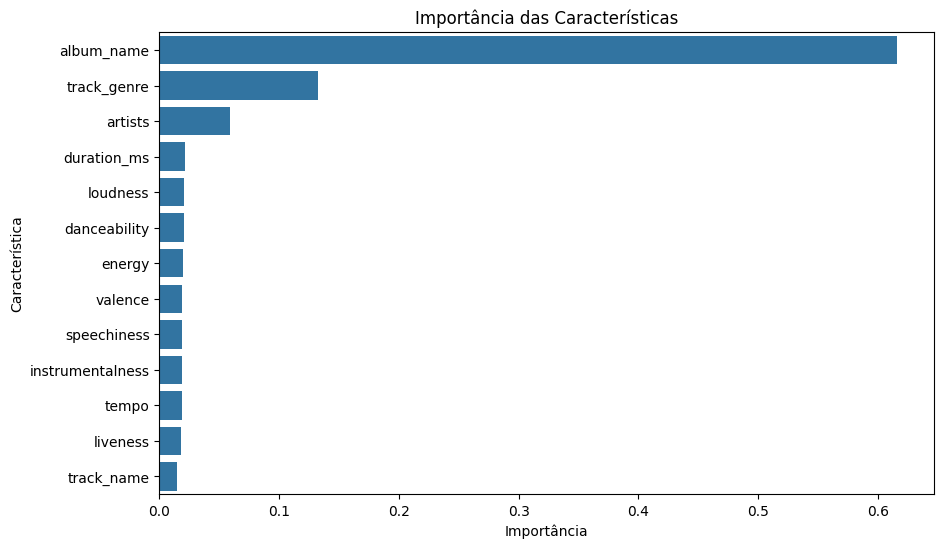

In [16]:
feature_importance(pipeline_rf_regressor,continuous_features,categorical_features)

In [17]:
plot_learning_curve(pipeline_rf_regressor, X_train, y_train, cv=5, n_jobs=-1)

In [18]:
from sklearn.metrics import mean_absolute_error, r2_score
# Make predictions on the test set
y_pred = pipeline_rf_regressor.predict(X_test)

# Calculate the accuracy of the model
print(mean_absolute_error(y_test, y_pred))
print(r2_score(y_test, y_pred))

5.808196164866652
0.8287431141642229


In [19]:
# Definir os parâmetros a serem testados
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# busca_melhor_modelo(pipeline_rf_regressor, param_grid, X_train, y_train, 'r2', cv=5)

##### Teste 2

Modelo: SGD Regressor

Variáveis: Todas

Label: Popularity (valores inteiros de 0 a 100)

In [20]:
from sklearn.linear_model import SGDRegressor
from sklearn.model_selection import train_test_split

X = df_cleaned.drop(['popularity'], axis=1)
y = df_cleaned['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature']

pipeline_sgd_regressor = preprocessing(SGDRegressor(random_state=42), categorical_features, continuous_features)

# Treinar a pipeline
pipeline_sgd_regressor.fit(X_train, y_train)

/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_stochastic_gradient.py:1616: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', SGDRegressor(random_state=42))])

In [21]:
from sklearn.metrics import mean_absolute_error, r2_score
# Make predictions on the test set
y_pred = pipeline_sgd_regressor.predict(X_test)

# Calculate the accuracy of the model
print(mean_absolute_error(y_test, y_pred))
print(r2_score(y_test, y_pred))

88531.27507333341
-40765753.41276124


In [22]:
# plot_learning_curve(pipeline_sgd_regressor, X_train, y_train, cv=5, n_jobs=-1)

Análise de correlação

Removeremos as variáveis energy, acousticness, pois como vimos anteriormente são variáveis altamente correlacionadas. Removeremos também a variável key, pois tem uma correlação muito baixo com a variável resposta.

In [23]:
df_cleaned_reduced = df_cleaned.drop(['energy','acousticness','key'], axis=1)
df_cleaned_reduced

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,-6.746,0,0.1430,0.000001,0.3580,0.7150,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,-17.235,1,0.0763,0.000006,0.1010,0.2670,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,-9.734,1,0.0557,0.000000,0.1170,0.1200,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,-18.515,1,0.0363,0.000071,0.1320,0.1430,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,-9.681,1,0.0526,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,-16.393,1,0.0422,0.928000,0.0863,0.0339,125.995,5,world-music
113996,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,-18.318,0,0.0401,0.976000,0.1050,0.0350,85.239,4,world-music
113997,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,-10.895,0,0.0420,0.000000,0.0839,0.7430,132.378,4,world-music
113998,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,-10.889,1,0.0297,0.000000,0.2700,0.4130,135.960,4,world-music


##### Teste 3

Modelo: Random Forest Regressor

Variáveis: Todas, exceto energy, acousticness e key

Label: Popularity (valores inteiros de 0 a 100)

Realizaremos a categorização de algumas variáveis para tentar linearizar o problema e testar se teremos melhora na performance do modelo para este caso.

In [24]:
def filter_tempo_by_popularity(x):
    
    result:str|None = None

    if x < 0 or x > 1000:
        result = 'unexpected-value'
    elif  x < 25 or x > 200:
        result = 'outlier'
    elif x < 50:
        result = 'x-low'
    elif x < 75:
        result = 'low'
    elif x < 100:
        result = 'mid-low'
    elif x < 125:
        result = 'mid'
    elif x < 150:
        result = 'mid-high'
    elif x < 175:
        result = 'high'
    elif x < 200:
        result = 'x-high'
    else:
        result = 'not-mapped'
    
    return result

In [25]:
def filter_duration_by_popularity(t_ms):
    C_MIN = 60
    C_MS = 1000

    t_min = t_ms/(C_MIN*C_MS)

    if t_min < 0.5:
        t_cat = '0.5'
    elif t_min < 1.5:
        t_cat = '1.5'
    elif t_min < 2.5:
        t_cat = '2.5'
    elif t_min < 3.0:
        t_cat = '3.0'
    elif t_min < 3.5:
        t_cat = '3.5'
    elif t_min < 4.0:
        t_cat = '4.0'
    elif t_min < 5.0:
        t_cat = '5.0'
    elif t_min < 7.0:
        t_cat = '6.0'
    elif t_min < 10:
        t_cat = '8.0'
    elif t_min < 15:
        t_cat = '9.0'
    else:
        t_cat = '10.0'
    
    return t_cat

In [26]:
import math

def ln_with_eps(x):
    ln_eps = 4e-2
    if abs(x) < ln_eps:
        x = ln_eps
    return math.log(x)

In [27]:
df_categ_cleaned = df_cleaned_reduced.copy()
df_categ_cleaned['tempo'] = df_categ_cleaned['tempo'].apply(filter_tempo_by_popularity)
df_categ_cleaned['duration_ms'] = df_categ_cleaned['duration_ms'].apply(filter_duration_by_popularity)
df_categ_cleaned['danceability'] = df_categ_cleaned['danceability'].apply(ln_with_eps)

In [28]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

X = df_categ_cleaned.drop(['popularity'], axis=1)
y = df_categ_cleaned['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_genre', 'duration_ms',  'tempo']
continuous_features = ['danceability', 'loudness',
       'speechiness', 'instrumentalness', 'liveness',
       'valence']

In [29]:
pipeline_rf_regressor = preprocessing(RandomForestRegressor(
    n_estimators=100,
    random_state=42,
    n_jobs=3), 
    categorical_features, continuous_features)

# Treinar a pipeline
pipeline_rf_regressor.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['danceability', 'loudness',
                                                   'speechiness',
                                                   'instrumentalness',
                                                   'liveness', 'valence']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre', 'duration_ms',
                                                   'tempo'])])),
                ('model', RandomForestRegressor(n_jobs=3, random_state=42))])

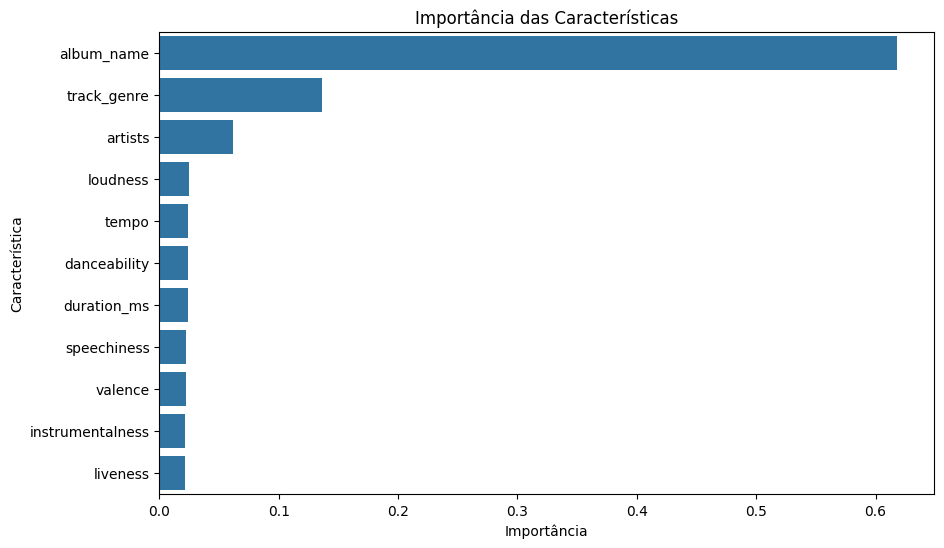

In [30]:
feature_importance(pipeline_rf_regressor,continuous_features,categorical_features)

In [31]:
plot_learning_curve(pipeline_rf_regressor, X_train, y_train, cv=5, n_jobs=2)

In [32]:
from sklearn.metrics import mean_absolute_error, r2_score
# Make predictions on the test set
y_pred = pipeline_rf_regressor.predict(X_test)

# Calculate the accuracy of the model
print(mean_absolute_error(y_test, y_pred))
print(r2_score(y_test, y_pred))

6.031660568657704
0.8212909243580258


##### Teste 4

Modelo: SGD Regressor

Variáveis: Todas, exceto energy, acousticness e key

Label: Popularity (valores inteiros de 0 a 100)

In [33]:
from sklearn.linear_model import SGDRegressor

pipeline_sgd_regressor = preprocessing(SGDRegressor(
                            random_state=42, 
                            max_iter=100000, 
                            learning_rate='adaptive'),
                        categorical_features, continuous_features)

# Treinar a pipeline
pipeline_sgd_regressor.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['danceability', 'loudness',
                                                   'speechiness',
                                                   'instrumentalness',
                                                   'liveness', 'valence']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre', 'duration_ms',
                                                   'tempo'])])),
                ('model',
                 SGDRegressor(learning_rate='adaptive', max_iter=100000,
                              random_state=42))])

In [34]:
# plot_learning_curve(pipeline_sgd_regressor, X_train, y_train, cv=5, n_jobs=-1)

In [35]:
from sklearn.metrics import mean_absolute_error, r2_score
# Make predictions on the test set
y_pred = pipeline_sgd_regressor.predict(X_test)

# Calculate the accuracy of the model
print(mean_absolute_error(y_test, y_pred))
print(r2_score(y_test, y_pred))

9.02318779540092
0.704454117885851


#### Problema de classificação
Podemos abordar este problema pelo ponto de vista de um modelo de classificação, vamos transformar a coluna popularity em classes e testar alguns modelos

##### Teste 1

Modelo: Random Forest Classifier

Variáveis: Todas

Label: Popularity (Se for que 50 é 0, se for maior ou igual a 50 é 1)

Primeiro, vamos transformar a coluna popularity em classes

In [12]:
df_cleaned_class = df_cleaned.copy()

df_cleaned_class['popularity'] = (df_cleaned_class['popularity'] >= 50).astype(int)

In [13]:
df_cleaned_class['popularity'].value_counts()

popularity
0    84080
1    29342
Name: count, dtype: int64

Será preciso balancear os dados para evitar o overfitting, vamos fazer um under sampling

In [14]:
from imblearn.under_sampling import RandomUnderSampler

# Inicializa o RandomUnderSampler
rus = RandomUnderSampler(random_state=42)

# Aplica o undersampling no conjunto de dados
X_resampled, y_resampled = rus.fit_resample(df_cleaned_class.drop('popularity', axis=1), df_cleaned_class['popularity'])

# Cria um novo DataFrame com os dados balanceados
df_balanced = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=['popularity'])], axis=1)

In [15]:
df_balanced.shape

(58684, 19)

In [16]:
df_balanced['popularity'].value_counts()

popularity
0    29342
1    29342
Name: count, dtype: int64

Agora, com os dados balanceados, podemos realizar o treinamento do modelo

In [41]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['popularity'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature']

model = RandomForestClassifier()
pipeline_rf_classifier = preprocessing(model, categorical_features, continuous_features)

pipeline_rf_classifier.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', RandomForestClassifier())])

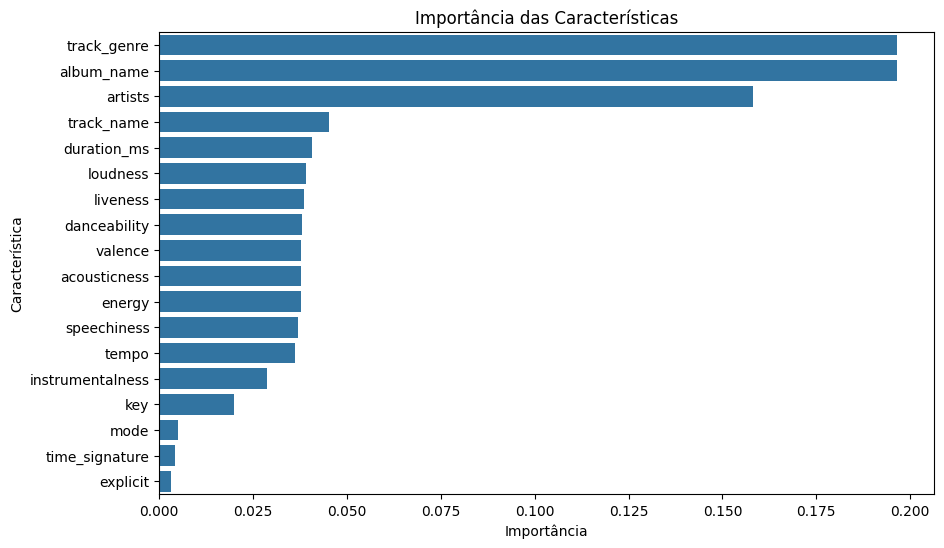

In [42]:
feature_importance(pipeline_rf_classifier,continuous_features,categorical_features)


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipelin

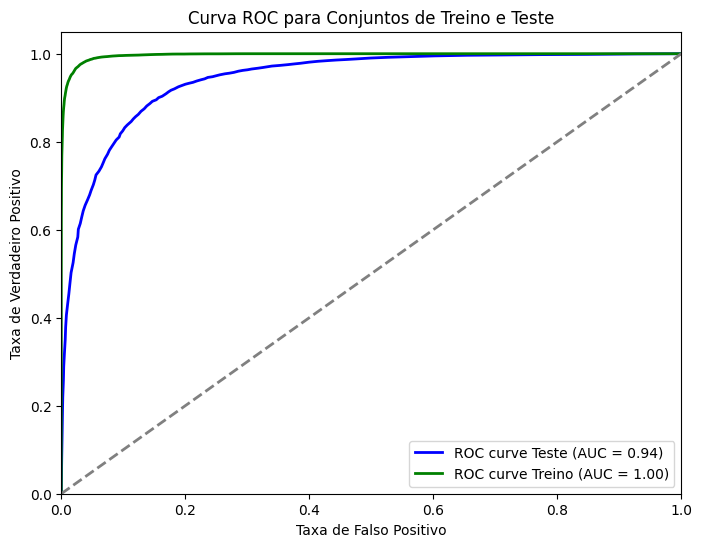

In [43]:
avalia_modelo_classificacao(pipeline_rf_classifier, X_train, y_train, X_test, y_test)

In [44]:
plot_learning_curve(pipeline_rf_classifier, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 2

Vamos tentar diminuir o overfitting tirando as variáveis menos importantes para o modelo

Modelo: Random Forest Classifier

Variáveis: ['artists', 'album_name','track_genre','duration_ms', 'loudness']

Label: Popularity (Se for que 50 é 0, se for maior ou igual a 50 é 1)

In [45]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['liveness', 'valence', 'speechiness', 'acousticness', 'danceability', 'energy','tempo','popularity','key','mode','time_signature','explicit','instrumentalness','track_name'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name','track_genre']
continuous_features = [ 'loudness', 'duration_ms']

model = RandomForestClassifier()
pipeline_rf_classifier_2 = preprocessing(model, categorical_features, continuous_features)

pipeline_rf_classifier_2.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', RandomForestClassifier())])

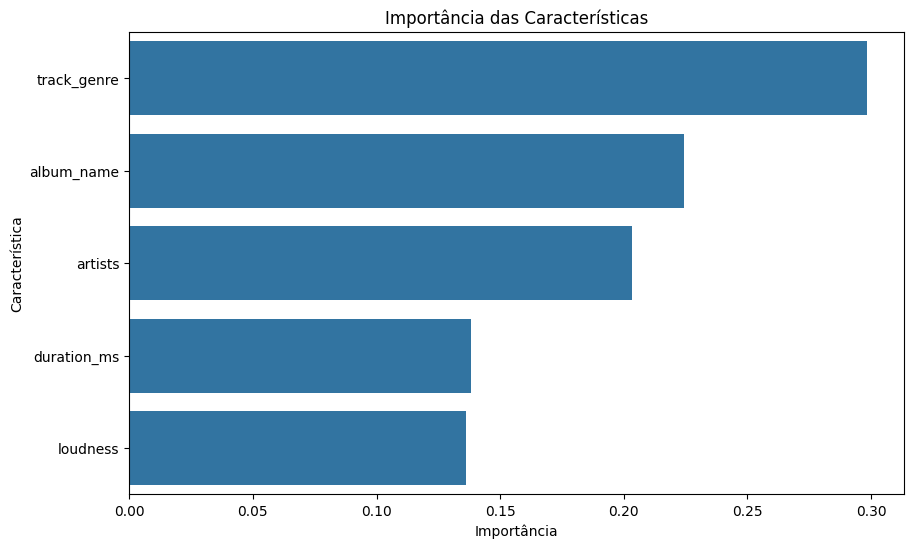

In [46]:
feature_importance(pipeline_rf_classifier_2,continuous_features,categorical_features)


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', RandomForestClassifier())])------------------------------

AUC (Teste) 0.93
AUC (Treino) 0.98

Classification Report
              precision    recall  f1-score   support

           0       0.85      0.85      0.85      5817
  

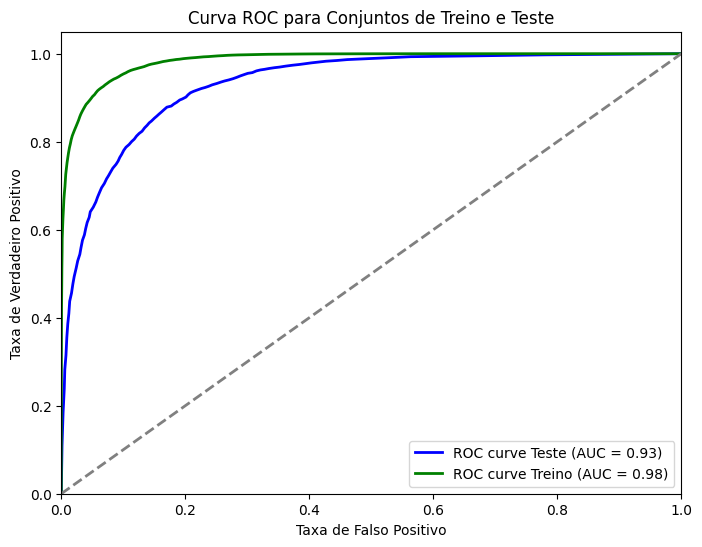

In [47]:
avalia_modelo_classificacao(pipeline_rf_classifier_2, X_train, y_train, X_test, y_test)

In [48]:
plot_learning_curve(pipeline_rf_classifier_2, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 3

Modelo: SVC

Variáveis: Todas

Label: Popularity (Se for que 50 é 0, se for maior ou igual a 50 é 1)

In [49]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['popularity'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature']

model = SVC(random_state=42,probability=True)
pipeline_svc_classifier = preprocessing(model, categorical_features, continuous_features)

pipeline_svc_classifier.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', SVC(probability=True, random_state=42))])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipelin

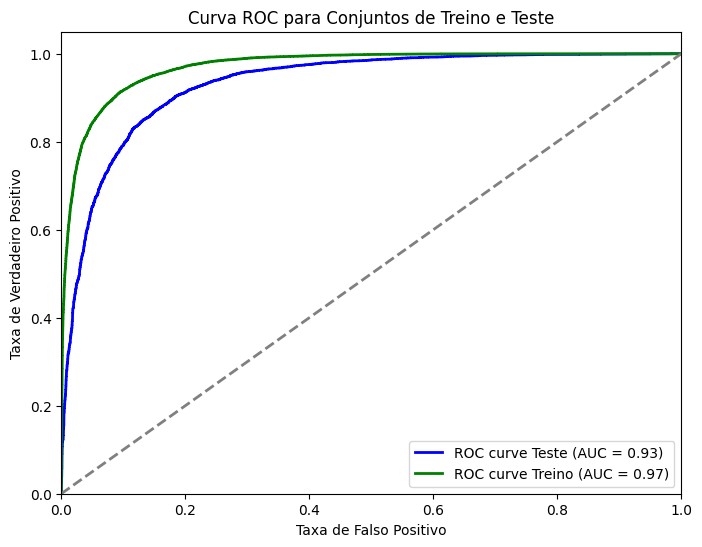

In [50]:
avalia_modelo_classificacao(pipeline_svc_classifier, X_train, y_train, X_test, y_test)

In [51]:
# plot_learning_curve(pipeline_svc_classifier, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 4

Modelo: KNN

Variáveis: Todas

Label: Popularity (Se for que 50 é 0, se for maior ou igual a 50 é 1)

In [52]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['popularity'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature']

model = KNeighborsClassifier(n_neighbors=3, metric= 'euclidean', weights='distance')
pipeline_knn_classifier = preprocessing(model, categorical_features, continuous_features)

pipeline_knn_classifier.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model',
                 KNeighborsClassifier(metric='euclidean', n_neighbors=3,
                                      weights='distance'))])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipelin

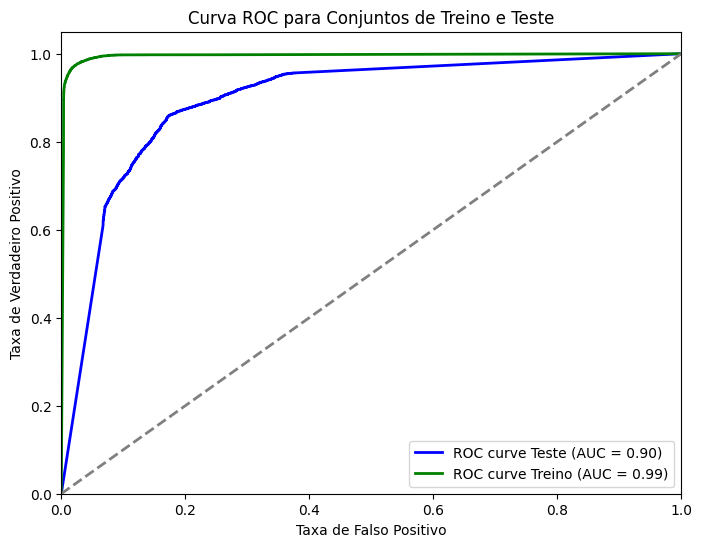

In [53]:
avalia_modelo_classificacao(pipeline_knn_classifier, X_train, y_train, X_test, y_test)

In [54]:
# plot_learning_curve(pipeline_knn_classifier, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 5

Modelo: SVC

Variáveis: Variáveis: ['artists', 'album_name','track_genre','duration_ms', 'loudness']


Label: Popularity (Se for que 50 é 0, se for maior ou igual a 50 é 1)

In [55]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['liveness', 'valence', 'speechiness', 'acousticness', 'danceability', 'energy','tempo','popularity','key','mode','time_signature','explicit','instrumentalness','track_name'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name','track_genre']
continuous_features = [ 'loudness', 'duration_ms']

model = RandomForestClassifier()
pipeline_svc_classifier_2 = preprocessing(model, categorical_features, continuous_features)

pipeline_svc_classifier_2.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', RandomForestClassifier())])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', RandomForestClassifier())])------------------------------

AUC (Teste) 0.93
AUC (Treino) 0.98

Classification Report
              precision    recall  f1-score   support

           0       0.85      0.85      0.85      5817
  

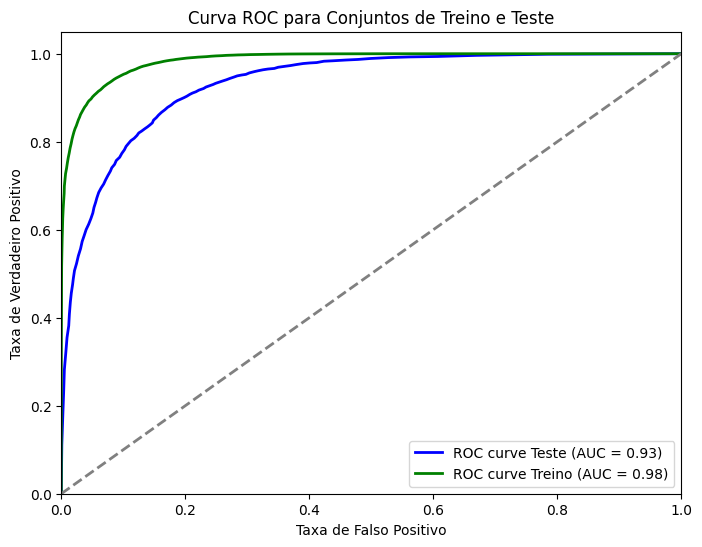

In [56]:
avalia_modelo_classificacao(pipeline_svc_classifier_2, X_train, y_train, X_test, y_test)

In [57]:
# plot_learning_curve(pipeline_svc_classifier_2, X_train, y_train, cv=5, n_jobs=-1)

Vamos reclassificar a coluna de popularidade pela mediana, para verificar se obtemos melhora na performance do modelo

In [17]:
df_cleaned_class_median = df_cleaned.copy()

df_cleaned_class_median['popularity'] = (df_cleaned_class_median['popularity'] >= 35).astype(int)

In [18]:
df_cleaned_class_median['popularity'].value_counts()

popularity
1    56959
0    56463
Name: count, dtype: int64

In [19]:
from imblearn.under_sampling import RandomUnderSampler

# Inicializa o RandomUnderSampler
rus = RandomUnderSampler(random_state=42)

# Aplica o undersampling no conjunto de dados
X_resampled, y_resampled = rus.fit_resample(df_cleaned_class_median.drop('popularity', axis=1), df_cleaned_class_median['popularity'])

# Cria um novo DataFrame com os dados balanceados
df_balanced = pd.concat([pd.DataFrame(X_resampled), pd.DataFrame(y_resampled, columns=['popularity'])], axis=1)

In [20]:
df_balanced.shape

(112926, 19)

In [21]:
df_balanced['popularity'].value_counts()

popularity
0    56463
1    56463
Name: count, dtype: int64

##### Teste 6

Modelo: SVC

Variáveis: Todas


Label: Popularity (Se for que 35 é 0, se for maior ou igual a 35 é 1)

Será preciso balancear os dados para evitar o overfitting, vamos fazer um under sampling

In [22]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['popularity'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature']

model = SVC(random_state=42,probability=True)
pipeline_svc_classifier_3 = preprocessing(model, categorical_features, continuous_features)

pipeline_svc_classifier_3.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', SVC(probability=True, random_state=42))])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms', 'explicit',
                                                   'danceability', 'energy',
                                                   'key', 'loudness', 'mode',
                                                   'speechiness',
                                                   'acousticness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo', 'time_signature']),
                                                 ('cat',
                                                  Pipelin

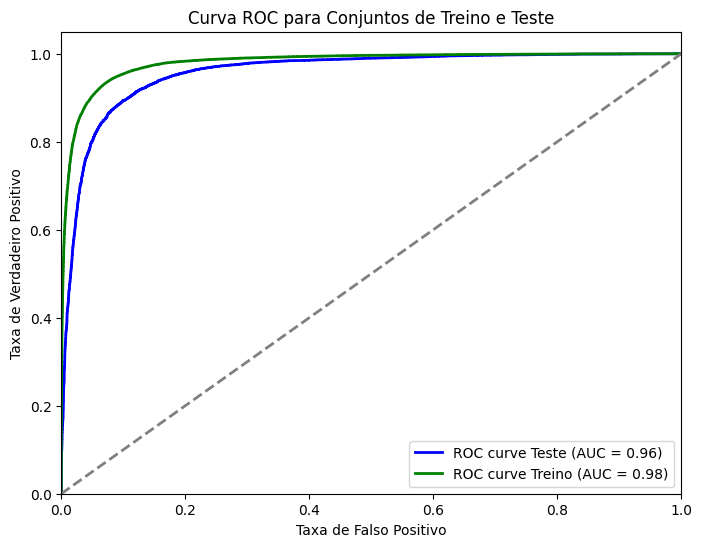

In [23]:
avalia_modelo_classificacao(pipeline_svc_classifier_3, X_train, y_train, X_test, y_test)

In [24]:
# plot_learning_curve(pipeline_svc_classifier_3, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 7

Modelo: SVC

Variáveis: ['artists', 'album_name', 'track_name','track_genre', 'duration_ms',
        'danceability', 'energy', 'loudness', 
       'speechiness', 'instrumentalness', 'liveness',
       'valence', 'tempo']


Label: Popularity (Se for que 35 é 0, se for maior ou igual a 35 é 1)

In [25]:

from sklearn.model_selection import train_test_split

X = df_balanced.drop(['popularity','acousticness','explicit', 'time_signature', 'mode','key'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name', 'track_name','track_genre']
continuous_features = ['duration_ms',
        'danceability', 'energy', 'loudness', 
       'speechiness', 'instrumentalness', 'liveness',
       'valence', 'tempo']
model = SVC(random_state=42,probability=True)
pipeline_svc_classifier_4 = preprocessing(model, categorical_features, continuous_features)

pipeline_svc_classifier_4.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms',
                                                   'danceability', 'energy',
                                                   'loudness', 'speechiness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_name',
                                                   'track_genre'])])),
                ('model', SVC(probability=True, random_state=42))])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['duration_ms',
                                                   'danceability', 'energy',
                                                   'loudness', 'speechiness',
                                                   'instrumentalness',
                                                   'liveness', 'valence',
                                                   'tempo']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['a

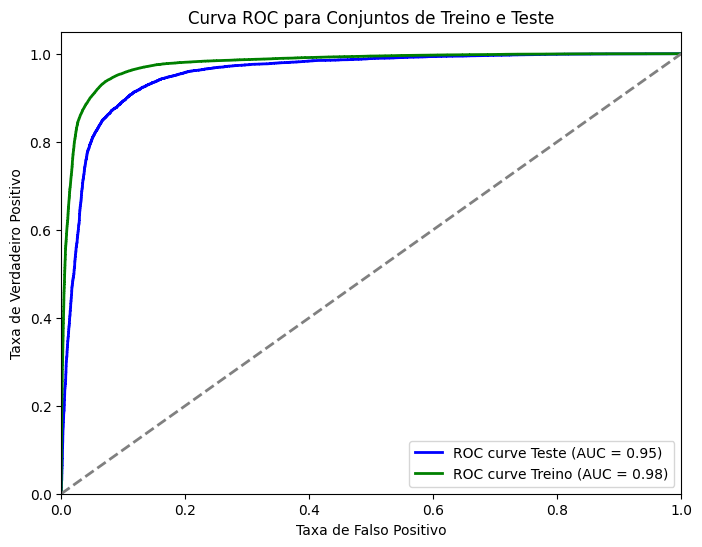

In [26]:
# avalia_modelo_classificacao(pipeline_svc_classifier_4, X_train, y_train, X_test, y_test)

In [27]:
plot_learning_curve(pipeline_svc_classifier_4, X_train, y_train, cv=5, n_jobs=-1)

  Análise com popularity binária

In [28]:
from ydata_profiling import ProfileReport

# Generate a profiling report
profile = ProfileReport(df_balanced, title="YData Profiling Report", explorative=True)

# To display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

##### Teste 8

Modelo: SVC

Variáveis: ['artists', 'album_name','track_genre', 'loudness', 'duration_ms']


Label: Popularity (Se for que 35 é 0, se for maior ou igual a 35 é 1)

In [29]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['liveness', 'valence', 'speechiness', 'acousticness', 'danceability', 'energy','tempo','popularity','key','mode','time_signature','explicit','instrumentalness','track_name'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name','track_genre']
continuous_features = [ 'loudness', 'duration_ms']

model = SVC(random_state=42,probability=True)
pipeline_svc_classifier_5 = preprocessing(model, categorical_features, continuous_features)

pipeline_svc_classifier_5.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', SVC(probability=True, random_state=42))])


------------------------------Resultados Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   MinMaxScaler())]),
                                                  ['loudness', 'duration_ms']),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   CatBoostEncoder())]),
                                                  ['artists', 'album_name',
                                                   'track_genre'])])),
                ('model', SVC(probability=True, random_state=42))])------------------------------

AUC (Teste) 0.94
AUC (Treino) 0.97

Classification Report
              precision    recall  f1-score   support

           0       0.89      0.89      0.8

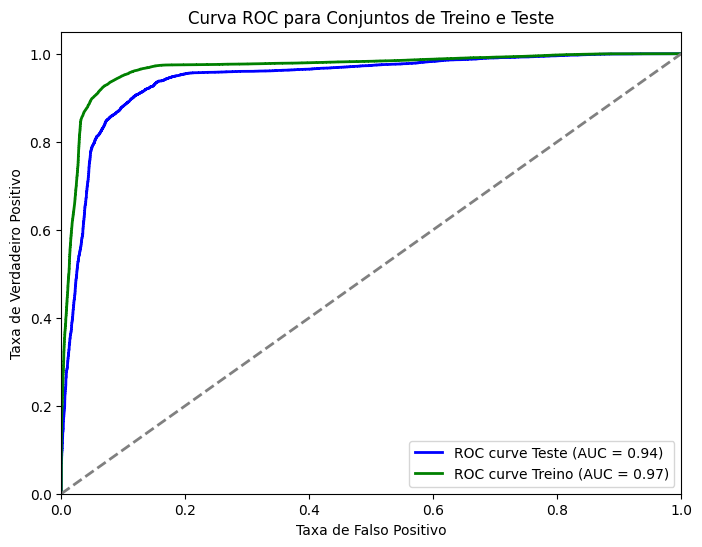

In [30]:
avalia_modelo_classificacao(pipeline_svc_classifier_5, X_train, y_train, X_test, y_test)

In [31]:
plot_learning_curve(pipeline_svc_classifier_5, X_train, y_train, cv=5, n_jobs=-1)

##### Teste 9

Modelo: Grid Search SVC

Variáveis: ['artists', 'album_name','track_genre', 'loudness', 'duration_ms']


Label: Popularity (Se for que 35 é 0, se for maior ou igual a 35 é 1)

In [32]:
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split

X = df_balanced.drop(['liveness', 'valence', 'speechiness', 'acousticness', 'danceability', 'energy','tempo','popularity','key','mode','time_signature','explicit','instrumentalness','track_name'], axis=1)
y = df_balanced['popularity']

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

categorical_features = ['artists', 'album_name','track_genre']
continuous_features = [ 'loudness', 'duration_ms']

model = SVC(random_state=42, probability=True, verbose=3)
pipeline_svc_classifier_6 = preprocessing(model, categorical_features, continuous_features)

In [33]:
param_grid = param_grid = {'model__C': [0.1, 1, 10, 100, 1000],
              'model__gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'model__kernel': ['rbf']}

# best_model = busca_melhor_modelo(pipeline_svc_classifier_6, param_grid, X_train, y_train, 'accuracy', cv=5)

[LibSVM]..........
*.
*
optimization finished, #iter = 11009
obj = -1667.100218, rho = 0.092743
nSV = 17016, nBSV = 16998
Total nSV = 17016
..........
*
optimization finished, #iter = 10966
obj = -1665.210404, rho = 0.100552
nSV = 17000, nBSV = 16982
Total nSV = 17000
...........
*
optimization finished, #iter = 11104
obj = -1673.520926, rho = 0.110705
nSV = 17093, nBSV = 17068
Total nSV = 17093
..........
*.
*
optimization finished, #iter = 11035
obj = -1679.309779, rho = 0.021049
nSV = 17138, nBSV = 17113
Total nSV = 17138
..........
*
optimization finished, #iter = 10814
obj = -1661.780896, rho = 0.123761
nSV = 16968, nBSV = 16948
Total nSV = 16968
.............
*.
*
optimization finished, #iter = 14145
obj = -2077.821416, rho = -0.056489
nSV = 21180, nBSV = 21156
Total nSV = 21180
[LibSVM]..........
*
optimization finished, #iter = 10978
obj = -1697.796150, rho = 0.110801
nSV = 17319, nBSV = 17303
Total nSV = 17319
...........
*.
*
optimization finished, #iter = 11313
obj = -1698.5

.....

In [ ]:
# avalia_modelo_classificacao(best_model, X_train, y_train, X_test, y_test)

In [ ]:
# plot_learning_curve(best_model, X_train, y_train, cv=5, n_jobs=-1)

## Notas

* Não foi realizada uma análise de impacto da limpeza dos dados textuais (como por exemplo, remover artigos/preposições: 'the', 'of').


## Comentários, TO DO's

* Inserir mais métricas no último teste? (e.g. KS)